In [1]:
include("TontiDiagrams.jl")
using .Tonti
using CombinatorialSpaces
using DifferentialEquations
using Plots

## Generate the complex and define the physics

The complex we define will be a regular triangular lattice, and only serves to store the spring connection information between particles.

Even though meshes already can be imported from mesh files, this current interface for defining simplicial complexes will be replaced by a more concise operadic interface.

In [2]:
width = 30
height = 30
num_oscillators = width*height

# Initialize complex and add points
s = OrientedDeltaSet1D{Bool}()
add_vertices!(s, num_oscillators)

ind(x,y) = x + (y-1)*(width)
tri_ind(x,y) = x + (y-1)*(width-1)*2

# Insert springs between points
for y in 1:(height-1)
    for x in 1:(width-1)
        if y % 2 == 1
            add_sorted_edges!(s,[ind(x,y),ind(x,y),ind(x,y)],
                                [ind(x+1,y),ind(x,y+1),ind(x+1,y+1)])
        else
            add_sorted_edges!(s,[ind(x,y),ind(x,y),ind(x,y+1)],
                                [ind(x+1,y),ind(x,y+1),ind(x+1,y)])
        end
    end
end
# Add the top and rhs
add_sorted_edges!(s, [ind(x,height) for x in 1:(width-1)], [ind(x,height) for x in 2:(width)])
add_sorted_edges!(s, [ind(width,y) for y in 1:(height-1)], [ind(width,y) for y in 2:(height)]);

## Define Tonti Diagrams
Initialize the tonti diagrams for the x and y dynamics (positions are now just attributes on the points of the simplex)

In [3]:
tdx = TontiDiagram(1, [:x =>:IP,  :vx =>:TP,  :Δx=>:IL,
                       :px=>:IL2, :∑fx=>:TL2, :fx=>:TP2]);
tdy = TontiDiagram(1, [:y=>:IP,   :vy =>:TP,  :Δy=>:IL,
                       :py=>:IL2, :∑fy=>:TL2, :fy=>:TP2]);

## Add the Physics

Here we add the constitutive relationships to each of the defined Tonti diagrams. 

Currently constitutive relationships are encoded as Julia functions, though these will soon be replaced by symbolic expressions.

In [4]:
# Define the physical constants
x0 = 1
k = 0.1
m = 1

# Define the principle of inertia (p=mv => v=p/m)
addTransform!(tdx, [:px], p->[p[1]/m], [:vx]);
addTransform!(tdy, [:py], p->[p[1]/m], [:vy]);

# Add the topological and temporal relations
# Note that these can be automatically added based on the location of variables in the Tonti diagram
addSpace!(tdx, s)
addSpace!(tdy, s)
addTime!(tdx)
addTime!(tdy)

# Merge the two diagrams to allow radial Hooke's law to be defined
td = disj_union(tdx, tdy);

# Add in radial Hooke's law
unit(x) = x / sqrt(x[1]^2+x[2]^2)
addTransform!(td, [:Δx, :Δy], Δx->k*(x0*unit(Δx) - Δx), [:fx, :fy]);

## Generate the simulation and solve it
The `vectorfield` function creates a dependency based on variables and relationships between them. This provides a schedule for the simulation and identifies which variables need to be provided as state variables.

In this case, the necessary state variables are position `x, y` and momentum `px, py`.

In [5]:
## Generate vectorfield

sim, data_syms = vectorfield(td, s)
data_syms

4-element Array{Pair{Symbol,Int64},1}:
  :x => 900
 :px => 900
  :y => 900
 :py => 900

In [6]:
## 2D Harmonic system without viscosity

# Here we define the initial conditions (square grid)
data_length = [data_syms[k][2] for k in keys(data_syms)]
du = zeros(sum(data_length))
u = [zeros(l) for l in data_length]

for y in 1:(height)
    for x in 1:(width)
        u[1][ind(x,y)] = x * x0 * 0.9
        u[3][ind(x,y)] = y * x0 * 0.9
    end
end

prob = ODEProblem(sim, vcat(u...), (0,1000.0))
sol = solve(prob);


## Visualize results

We use the Plots.jl library to show the particle system as a scatterplot of their locations.

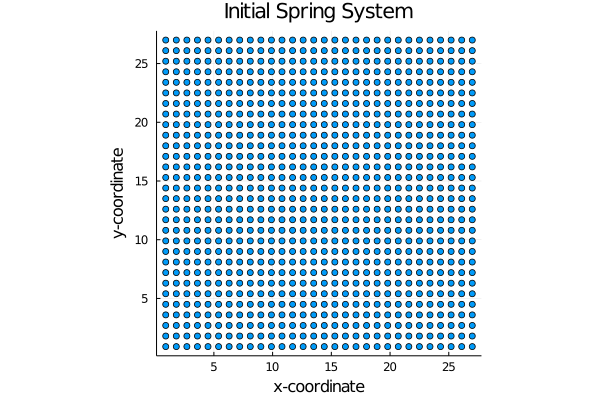

In [7]:
loc = sol(0)
x_loc = loc[1:data_syms[1][2]]
y_loc = loc[(1:data_syms[1][2]) .+ 2*data_syms[1][2]]
plot(x_loc, y_loc,
     legend=:none, seriestype = :scatter,
     xlabel="x-coordinate",ylabel="y-coordinate",
     title="Initial Spring System",
     ylims=[minimum(y_loc),maximum(y_loc)],
     xlims=[minimum(x_loc),maximum(x_loc)], ratio=1)


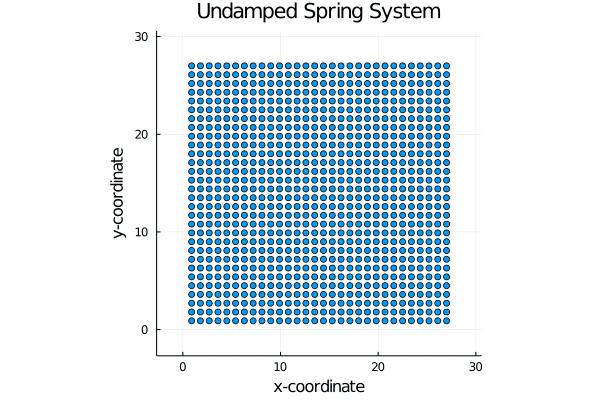

In [8]:

vals = sol(range(0, 500, length=200))
ylims = [minimum(vals),maximum(vals)]
xlims = [minimum(vals),maximum(vals)]

anim = @animate for loc ∈ vals
  xloc = loc[1:data_syms[1][2]]
  yloc = loc[(1:data_syms[1][2]) .+ 2*data_syms[1][2]]
  plot(xloc, yloc, legend=:none, seriestype = :scatter,
       xlabel="x-coordinate",ylabel="y-coordinate",
       title="Undamped Spring System",
       ylims=ylims, xlims=xlims, ratio=1)
end
gif(anim, fps = 30)

## Add viscosity to the system

Here we add in some viscosity to the medium of the system in order to damp the particle oscillations. This is introduced as $f_v = -k_{visc}v$

In [9]:
## 2D Harmonic system with viscosity
visc = 0.02
addTransform!(td, [:vx], v->(-v*visc), [:∑fx]);
addTransform!(td, [:vy], v->(-v*visc), [:∑fy]);

# Generate vectorfield and solve
simv, data_lengthv = vectorfield(td, s)

probv = ODEProblem(simv, vcat(u...), (0,1000.0))
solv = solve(probv);


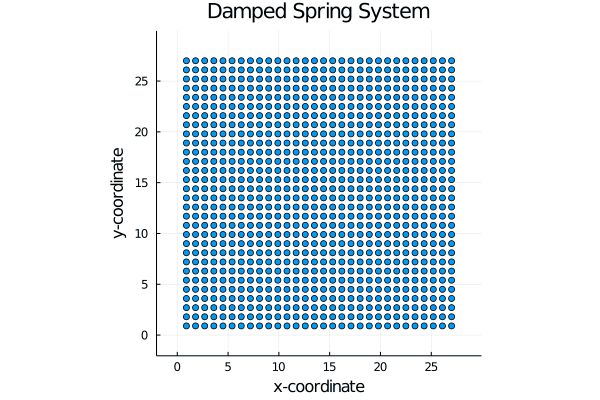

In [10]:
vals = solv(range(0, 500, length=200))
ylims = [minimum(vals),maximum(vals)]
xlims = [minimum(vals),maximum(vals)]

anim = @animate for loc ∈ vals
  xloc = loc[1:data_syms[1][2]]
  yloc = loc[(1:data_syms[1][2]) .+ 2*data_syms[1][2]]
  plot(xloc, yloc, legend=:none, seriestype = :scatter,
       xlabel="x-coordinate",ylabel="y-coordinate",
       title="Damped Spring System",
       ylims=ylims, xlims=xlims, ratio=1)
end
gif(anim, fps = 30)